# PREPARATION

## IMPORTS

In [1]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import os
import matplotlib.pyplot as plt
import warnings

2023-02-19 10:49:11.471460: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-19 10:49:11.609993: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [2]:
warnings.filterwarnings( "ignore", module = "matplotlib\..*" )
warnings.filterwarnings( "ignore", module = "tensorflow\..*" )

In [3]:
# Prevent CUDA from allowing all GPU memory, to avoid OOM errors
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
  tf.config.experimental.set_memory_growth(gpu, True)

2023-02-19 10:49:13.839670: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-19 10:49:13.855293: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-19 10:49:13.855474: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


## PARAMETERS DEFINITION

In [4]:
DATA_PATH = "images"
ROOT_PATH = '/home/guillaume/code/35m5loKiUe/WGAN_DATA/'
MODEL_PATH = 'model_saves'
GIF_PATH = 'gif_pics'

NB_FILTERS = 256
IMAGE_SIZE = 64
BUFFER_SIZE = 60000
BATCH_SIZE = 256
NOISE_DIM = 100
EPOCHS = 100
MODEL_SAVE_FRQ = 5

## DATASET LOADING

In [5]:
train_dataset = tf.keras.utils.image_dataset_from_directory(
    os.path.join(ROOT_PATH, DATA_PATH),
    label_mode=None,
    color_mode='rgb',
    batch_size=BATCH_SIZE,
    image_size=(IMAGE_SIZE,IMAGE_SIZE),
)

Found 302652 files belonging to 1 classes.


2023-02-19 10:49:25.335732: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-02-19 10:49:25.336693: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-19 10:49:25.336873: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2023-02-19 10:49:25.336995: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:980] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zer

In [6]:
#for images in train_dataset.take(1):
#    print(np.min(images[0]))
#    plt.axis("off")
#    break

In [7]:
normalization_layer = tf.keras.layers.Rescaling(scale=1./255)
train_dataset = train_dataset.map(lambda x: (normalization_layer(x)))

# MODEL DEFINITION

## GENERATOR

In [8]:
def get_generator_model(IMAGE_SIZE, NB_FILTERS):
    model = tf.keras.Sequential()
        
    # Dense layer to get sufficient dimensions to create 1st convolution
    model.add(layers.Dense(8 * 8 * NB_FILTERS, use_bias=False, input_shape=(100,)))
    model.add(layers.BatchNormalization())
    model.add(layers.LeakyReLU())
    
    # Reshape for 1st convolution
    model.add(layers.Reshape((8, 8, NB_FILTERS)))
    
    #Transpose convolution layers
    i = 16
    while i <= IMAGE_SIZE:      
        model.add(layers.Conv2DTranspose(i, (5, 5), strides=(2, 2), padding='same', use_bias=False))
        model.add(layers.BatchNormalization())
        model.add(layers.LeakyReLU())
        i = 2*i
    
    #Last convolution layer to return
    model.add(layers.Conv2D(3, (5, 5), strides=(1, 1), padding='same', use_bias=False, activation=None))
    model.add(layers.Activation('sigmoid'))

    return model

In [9]:
generator = get_generator_model(IMAGE_SIZE, NB_FILTERS)

## DISCRIMIATOR

In [10]:
def get_discriminator_model(IMAGE_SIZE, NB_FILTERS):
    model = tf.keras.Sequential()
       
    #Convolution layers
    i = IMAGE_SIZE
    while i <= NB_FILTERS:    
        model.add(layers.Conv2D(i, (5, 5), strides=(2, 2), padding='same'))
        model.add(layers.LeakyReLU())
        model.add(layers.Dropout(0.3))
        i = 2*i
      
    model.add(layers.Flatten())
    model.add(layers.Dropout(0.2))
    model.add(layers.Dense(1))

    return model

In [11]:
discriminator = get_discriminator_model(IMAGE_SIZE, NB_FILTERS)

## WGAN MODEL

In [12]:
class WGAN(keras.Model):
    def __init__(
        self,
        discriminator,
        generator,
        latent_dim,
        discriminator_extra_steps=3,
        gp_weight=10.0,
    ):
        super().__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_steps = discriminator_extra_steps
        self.gp_weight = gp_weight

    def compile(self, d_optimizer, g_optimizer, d_loss_fn, g_loss_fn):
        super().compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.d_loss_fn = d_loss_fn
        self.g_loss_fn = g_loss_fn

    def gradient_penalty(self, batch_size, real_images, fake_images):
        """Calculates the gradient penalty.
        This loss is calculated on an interpolated image
        and added to the discriminator loss.
        """
        # Get the interpolated image
        alpha = tf.random.normal(
            [batch_size, 1, 1, 1],
            mean=0.0,
            stddev=1.0
        )
        diff = fake_images - real_images
        interpolated = real_images + alpha * diff

        with tf.GradientTape() as gp_tape:
            gp_tape.watch(interpolated)
            # 1. Get the discriminator output for this interpolated image.
            pred = self.discriminator(interpolated, training=True)

        # 2. Calculate the gradients w.r.t to this interpolated image.
        grads = gp_tape.gradient(pred, [interpolated])[0]
        # 3. Calculate the norm of the gradients.
        norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
        gp = tf.reduce_mean((norm - 1.0) ** 2)
        return gp
    
    def train_step(self, real_images):
        if isinstance(real_images, tuple):
            real_images = real_images[0]

        # Get the batch size
        batch_size = tf.shape(real_images)[0]

        # For each batch, we are going to perform the
        # following steps as laid out in the original paper:
        # 1. Train the generator and get the generator loss
        # 2. Train the discriminator and get the discriminator loss
        # 3. Calculate the gradient penalty
        # 4. Multiply this gradient penalty with a constant weight factor
        # 5. Add the gradient penalty to the discriminator loss
        # 6. Return the generator and discriminator losses as a loss dictionary

        # Train the discriminator first. The original paper recommends training
        # the discriminator for `x` more steps (typically 5) as compared to
        # one step of the generator. Here we will train it for 3 extra steps
        # as compared to 5 to reduce the training time.
        
        for i in range(self.d_steps):
            # Get the latent vector
            random_latent_vectors = tf.random.normal(
                shape=(batch_size, self.latent_dim)
            )
            with tf.GradientTape() as tape:
                # Generate fake images from the latent vector
                fake_images = self.generator(random_latent_vectors, training=True)
                # Get the logits for the fake images
                fake_logits = self.discriminator(fake_images, training=True)
                # Get the logits for the real images
                real_logits = self.discriminator(real_images, training=True)

                # Calculate the discriminator loss using the fake and real image logits
                d_cost = self.d_loss_fn(real_img=real_logits, fake_img=fake_logits)
                # Calculate the gradient penalty
                gp = self.gradient_penalty(batch_size, real_images, fake_images)
                # Add the gradient penalty to the original discriminator loss
                d_loss = d_cost + gp * self.gp_weight

            # Get the gradients w.r.t the discriminator loss
            d_gradient = tape.gradient(d_loss, self.discriminator.trainable_variables)
            # Update the weights of the discriminator using the discriminator optimizer
            self.d_optimizer.apply_gradients(
                zip(d_gradient, self.discriminator.trainable_variables)
            )

        # Train the generator
        # Get the latent vector
        random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
        with tf.GradientTape() as tape:
            # Generate fake images using the generator
            generated_images = self.generator(random_latent_vectors, training=True)
            # Get the discriminator logits for fake images
            gen_img_logits = self.discriminator(generated_images, training=True)
            # Calculate the generator loss
            g_loss = self.g_loss_fn(gen_img_logits)

        # Get the gradients w.r.t the generator loss
        gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
        # Update the weights of the generator using the generator optimizer
        self.g_optimizer.apply_gradients(
            zip(gen_gradient, self.generator.trainable_variables)
        )
        return {"d_loss": d_loss, "g_loss": g_loss}

# MONITORING

In [13]:
class GANMonitor(keras.callbacks.Callback):
    def __init__(self, sqr_size=5, latent_dim=128, latent_vec=tf.random.normal(shape=(1,128))):
        self.sqr_size = sqr_size
        self.latent_dim = latent_dim
        self.latent_vec = latent_vec

    def on_epoch_end(self, epoch, logs=None):
        
        if not epoch%MODEL_SAVE_FRQ :
            self.model.generator.save(os.path.join(ROOT_PATH, MODEL_PATH, 'generator_after_epoch_{epoch}').format(epoch=epoch))
            self.model.discriminator.save(os.path.join(ROOT_PATH, MODEL_PATH, 'discriminator_after_epoch_{epoch}').format(epoch=epoch))
        
        
#        fig = plt.figure(figsize=(10, 10))
#        
#        for i in range(generated_images.shape[0]):
#            plt.subplot(self.sqr_size, self.sqr_size, i+1)
#            plt.imshow((generated_images[i, :, :, :]))
#            plt.axis('off')
#        plt.savefig(os.path.join(ROOT_PATH, GIF_PATH,'image_at_epoch_{:04d}.png').format(epoch))
#        plt.show()     + 127.5
#        
        generated_images = self.model.generator(self.latent_vec)
        #generated_images = (generated_images * 255)
        generated_images.numpy()

        fig = plt.figure(figsize=(10, 10))
        for i in range(generated_images.shape[0]):
            plt.subplot(self.sqr_size, self.sqr_size, i+1)
            img = keras.utils.array_to_img(generated_images[i]) 
            plt.imshow(img)
            plt.axis('off')
        plt.savefig(os.path.join(ROOT_PATH, GIF_PATH,'image_at_epoch_{:04d}.png').format(epoch)) 
        plt.show()
        
        #for i in range(self.num_img):
        #    img = generated_images[i].numpy()
        #    img = keras.preprocessing.image.array_to_img(img)
        #    img.save(os.path.join(ROOT_PATH, GIF_PATH, "generated_img_{i}_{epoch}.png").format(i=i, epoch=epoch))

# INSTANCIATION

## OPTIMIZER

In [14]:
# Instantiate the optimizer for both networks
# (learning_rate=0.0002, beta_1=0.5 are recommended)
generator_optimizer = keras.optimizers.Adam(
    learning_rate=0.0002, beta_1=0.5, beta_2=0.9
)
discriminator_optimizer = keras.optimizers.Adam(
    learning_rate=0.0002, beta_1=0.5, beta_2=0.9
)

## LOSSES FUNCTIONS

In [15]:
# Define the loss functions for the discriminator,
# which should be (fake_loss - real_loss).
# We will add the gradient penalty later to this loss function.
def discriminator_loss(real_img, fake_img):
    real_loss = tf.reduce_mean(real_img)
    fake_loss = tf.reduce_mean(fake_img)
    return fake_loss - real_loss


# Define the loss functions for the generator.
def generator_loss(fake_img):
    return -tf.reduce_mean(fake_img)

## MONITOR

In [16]:

# Instantiate the customer `GANMonitor` Keras callback.
latent_vec=tf.random.normal(shape=(5**2, NOISE_DIM))
cbk = GANMonitor(sqr_size=5, latent_dim=NOISE_DIM, latent_vec=latent_vec)

## MODEL

In [17]:
# Get the wgan model
wgan = WGAN(
    discriminator=discriminator,
    generator=generator,
    latent_dim=NOISE_DIM,
    discriminator_extra_steps=3,
)

In [18]:
# Compile the wga}n model
wgan.compile(
    d_optimizer=discriminator_optimizer,
    g_optimizer=generator_optimizer,
    g_loss_fn=generator_loss,
    d_loss_fn=discriminator_loss,
)

# TRAIN

Epoch 1/100


2023-02-19 10:49:31.933916: I tensorflow/stream_executor/cuda/cuda_blas.cc:1614] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.
2023-02-19 10:49:32.082133: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8700


1183/1183 [==============================] - ETA: 0s - d_loss: -4.5034 - g_loss: -1.2138WARNING:tensorflow:Compiled the loaded model, but the compiled metrics have yet to be built. `model.compile_metrics` will be empty until you train or evaluate the model.


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_0/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_0/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_0/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_0/assets


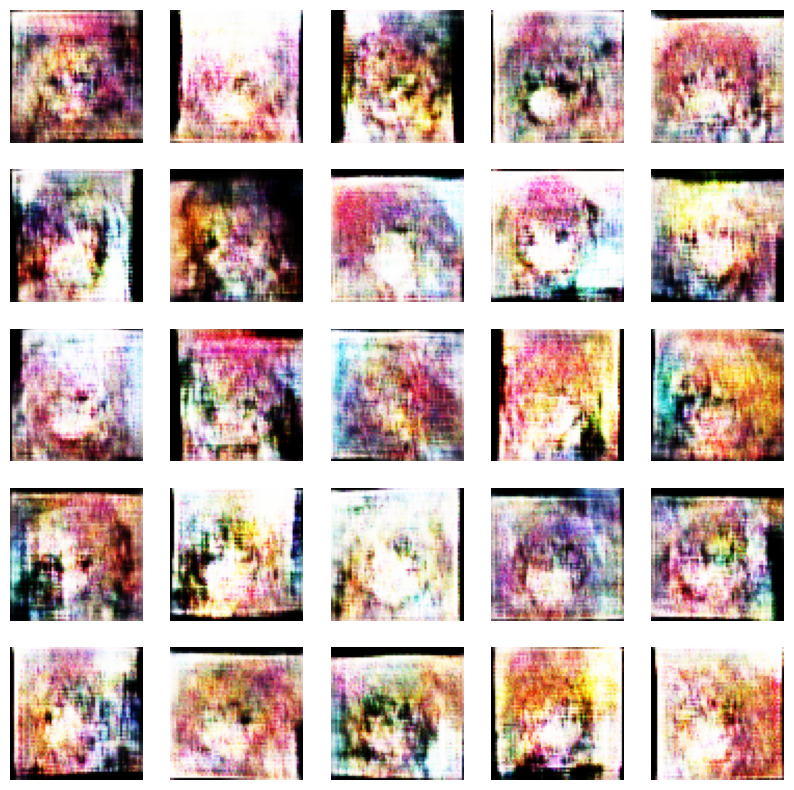

1183/1183 [==============================] - 699s 582ms/step - d_loss: -4.5026 - g_loss: -1.2213
Epoch 2/100
1183/1183 [==============================] - ETA: 0s - d_loss: -3.1717 - g_loss: -6.3341

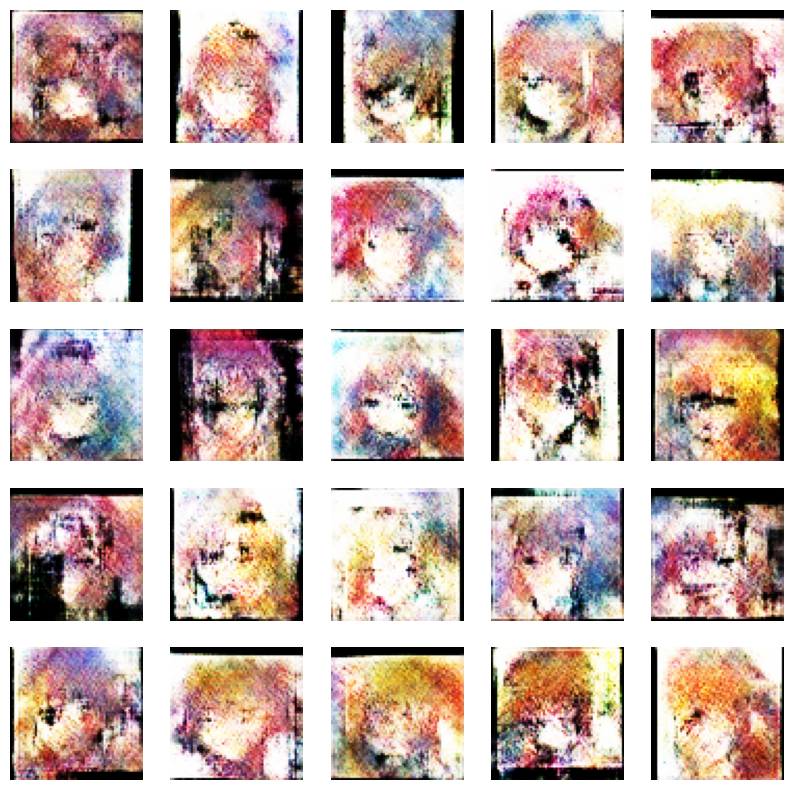

1183/1183 [==============================] - 684s 578ms/step - d_loss: -3.1721 - g_loss: -6.3418
Epoch 3/100
1183/1183 [==============================] - ETA: 0s - d_loss: -2.8274 - g_loss: 1.0128

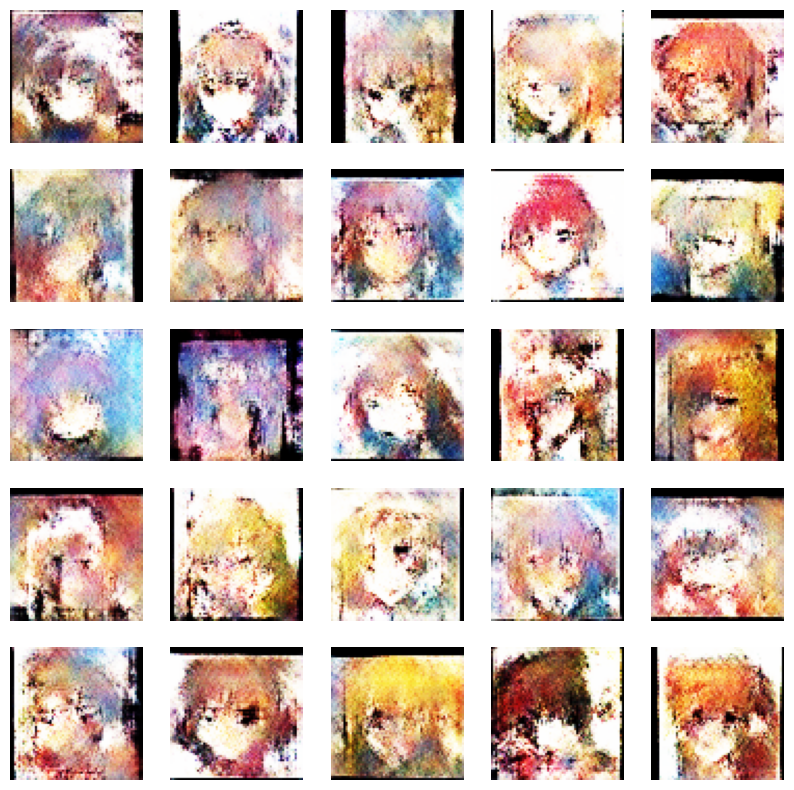

1183/1183 [==============================] - 691s 584ms/step - d_loss: -2.8278 - g_loss: 1.0205
Epoch 4/100
1183/1183 [==============================] - ETA: 0s - d_loss: -2.5467 - g_loss: -0.6618

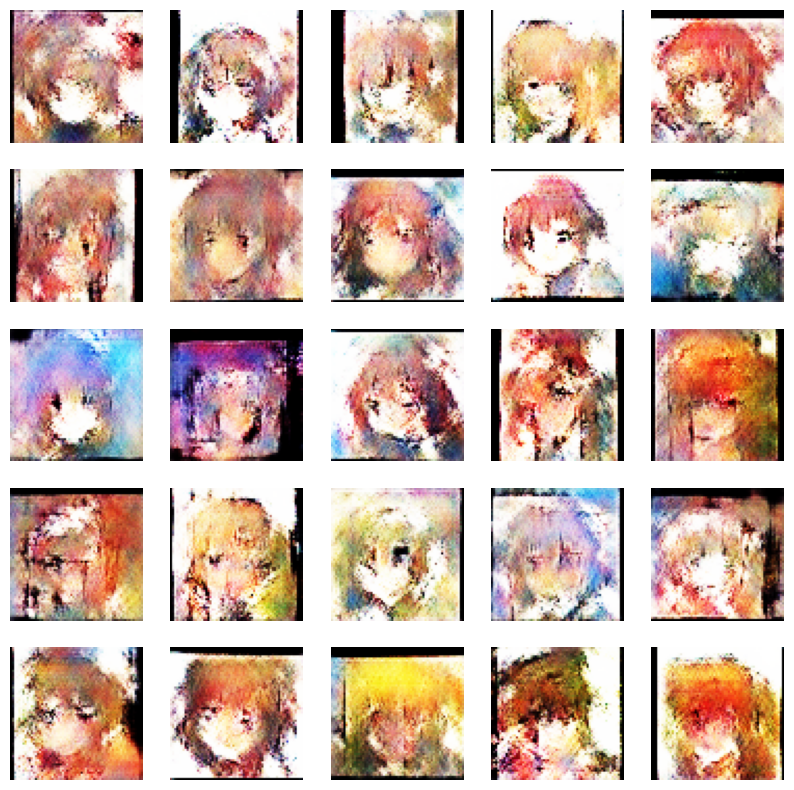

1183/1183 [==============================] - 701s 592ms/step - d_loss: -2.5461 - g_loss: -0.6521
Epoch 5/100
1183/1183 [==============================] - ETA: 0s - d_loss: -2.2930 - g_loss: -0.9059

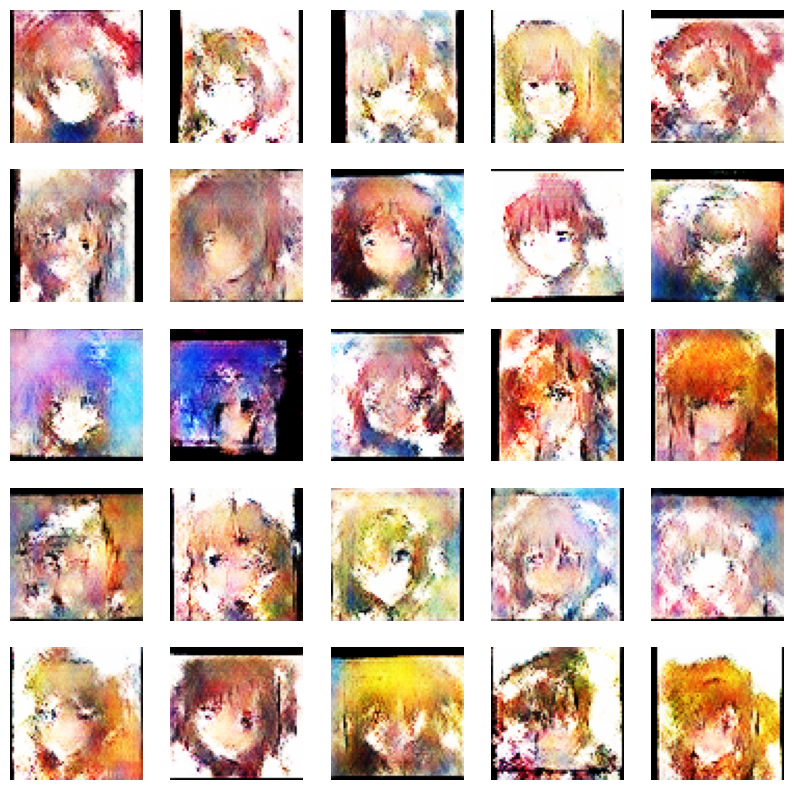

1183/1183 [==============================] - 693s 585ms/step - d_loss: -2.2938 - g_loss: -0.9012
Epoch 6/100
1183/1183 [==============================] - ETA: 0s - d_loss: -2.1154 - g_loss: 5.3993WARNING:tensorflow:Compiled the loaded model, but the compiled metrics have yet to be built. `model.compile_metrics` will be empty until you train or evaluate the model.


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_5/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_5/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_5/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_5/assets


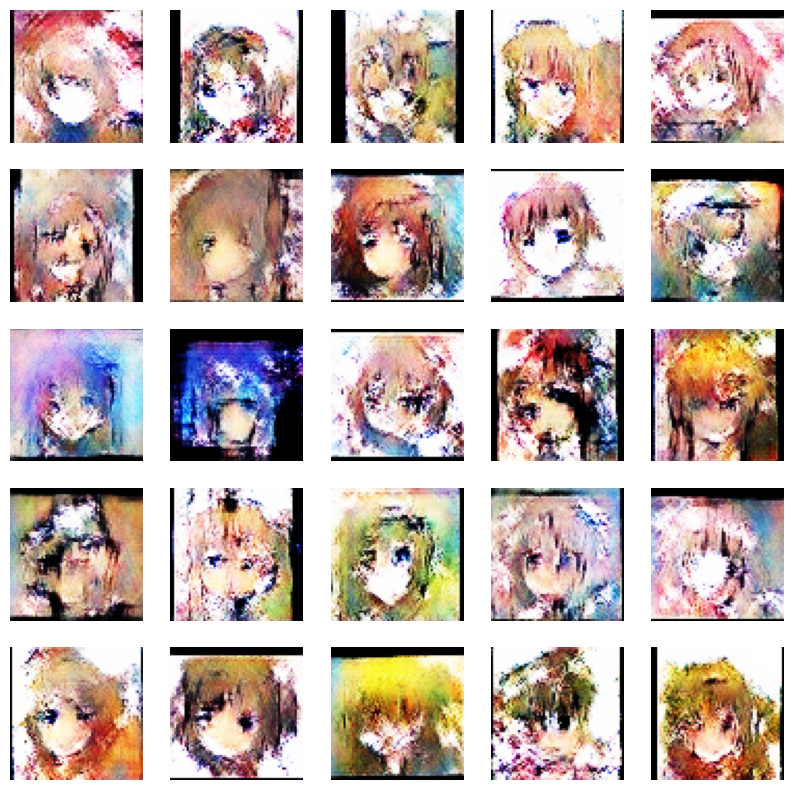

1183/1183 [==============================] - 688s 581ms/step - d_loss: -2.1157 - g_loss: 5.4045
Epoch 7/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.9663 - g_loss: 5.7517

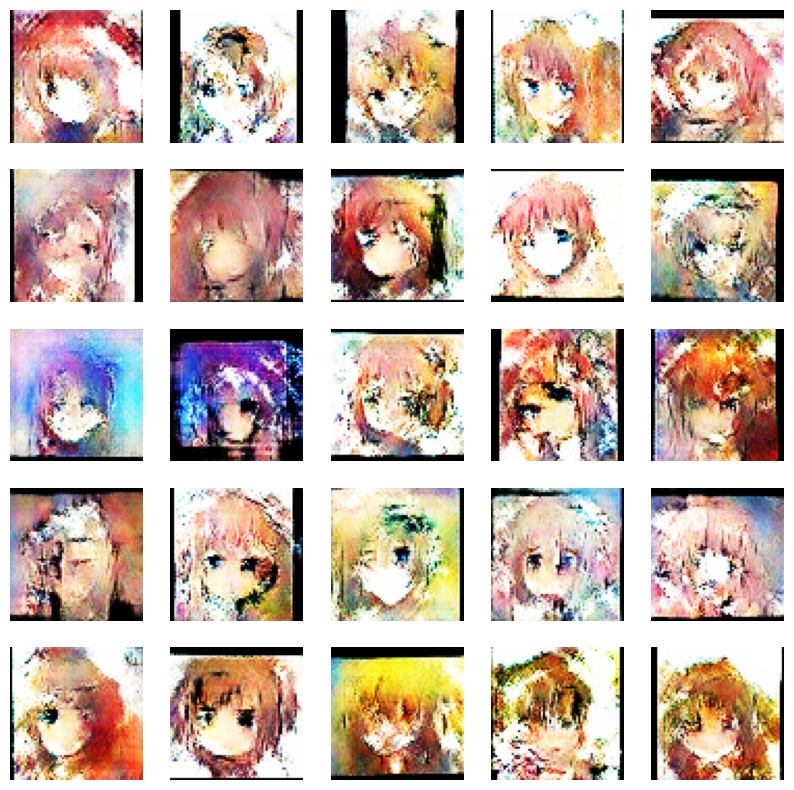

1183/1183 [==============================] - 683s 577ms/step - d_loss: -1.9664 - g_loss: 5.7453
Epoch 8/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.8483 - g_loss: 4.6884

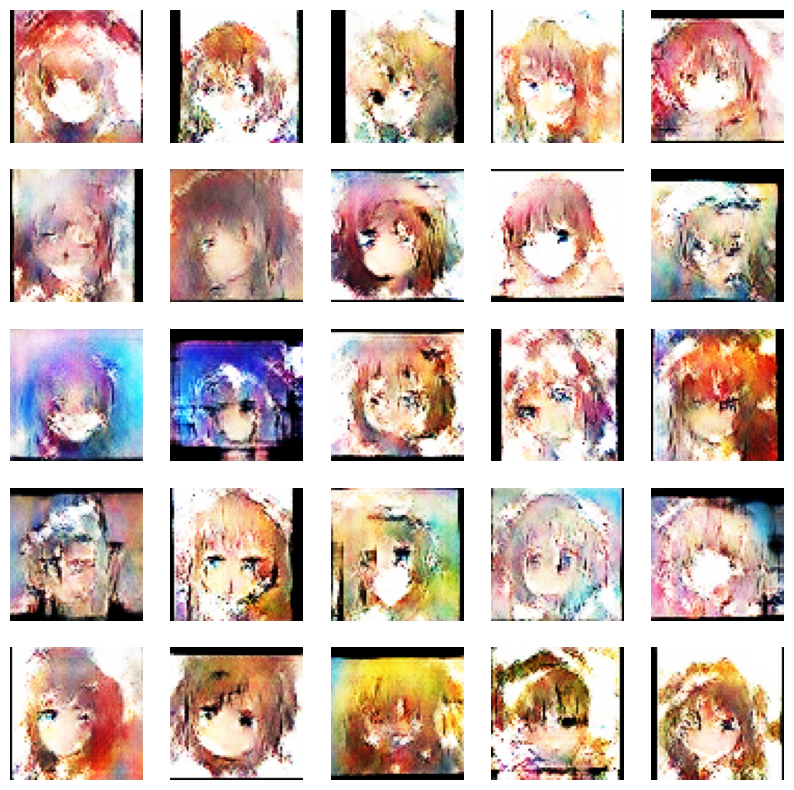

1183/1183 [==============================] - 690s 583ms/step - d_loss: -1.8488 - g_loss: 4.6828
Epoch 9/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.7209 - g_loss: 3.6956

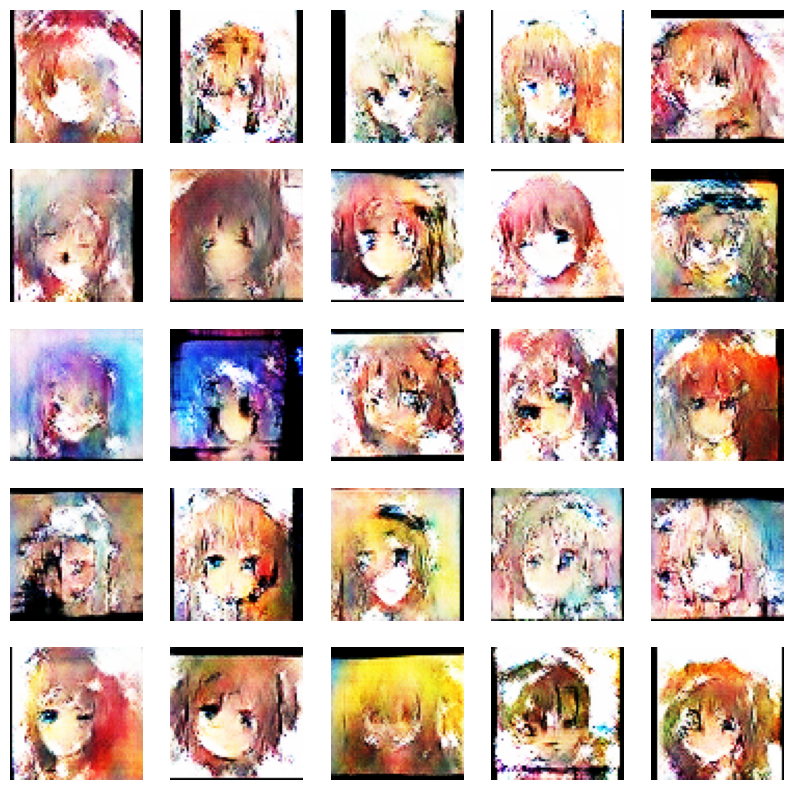

1183/1183 [==============================] - 688s 582ms/step - d_loss: -1.7208 - g_loss: 3.6990
Epoch 10/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.6448 - g_loss: 6.1516

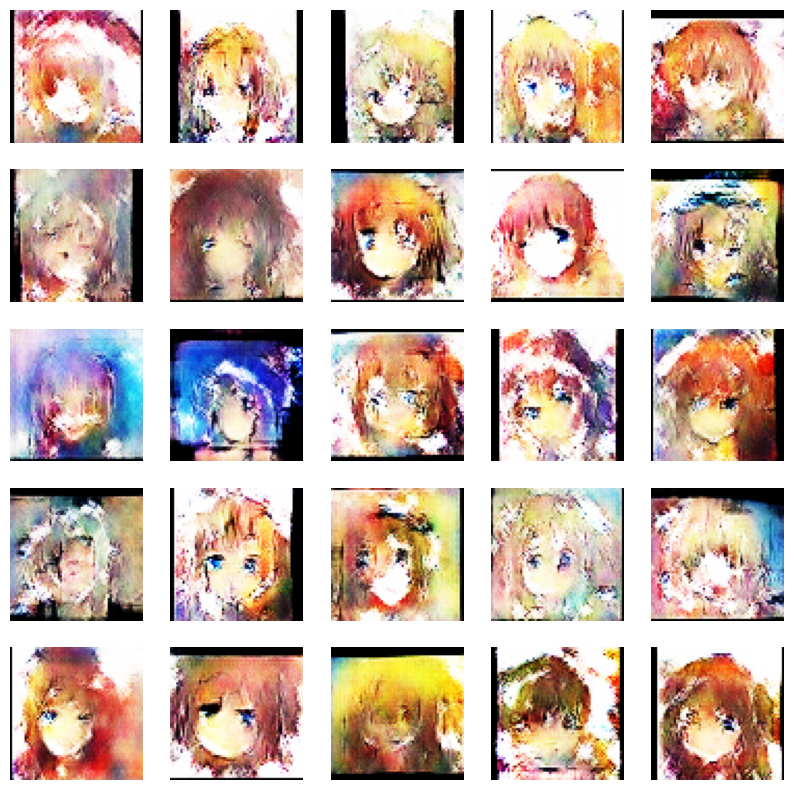

1183/1183 [==============================] - 682s 576ms/step - d_loss: -1.6448 - g_loss: 6.1467
Epoch 11/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.5964 - g_loss: 4.4252WARNING:tensorflow:Compiled the loaded model, but the compiled metrics have yet to be built. `model.compile_metrics` will be empty until you train or evaluate the model.


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_10/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_10/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_10/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_10/assets


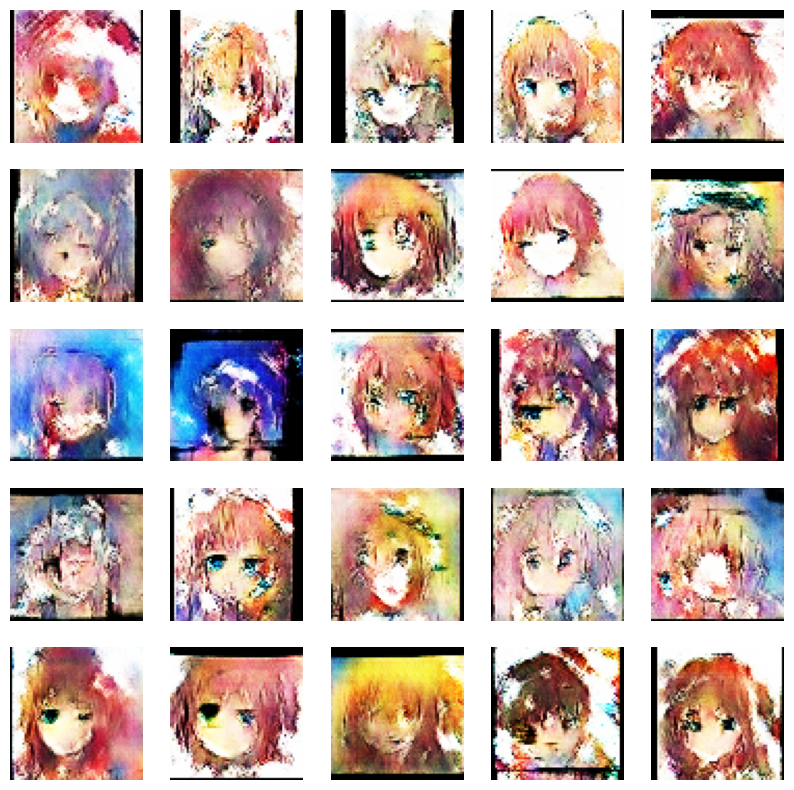

1183/1183 [==============================] - 698s 590ms/step - d_loss: -1.5962 - g_loss: 4.4257
Epoch 12/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.5108 - g_loss: 4.6337

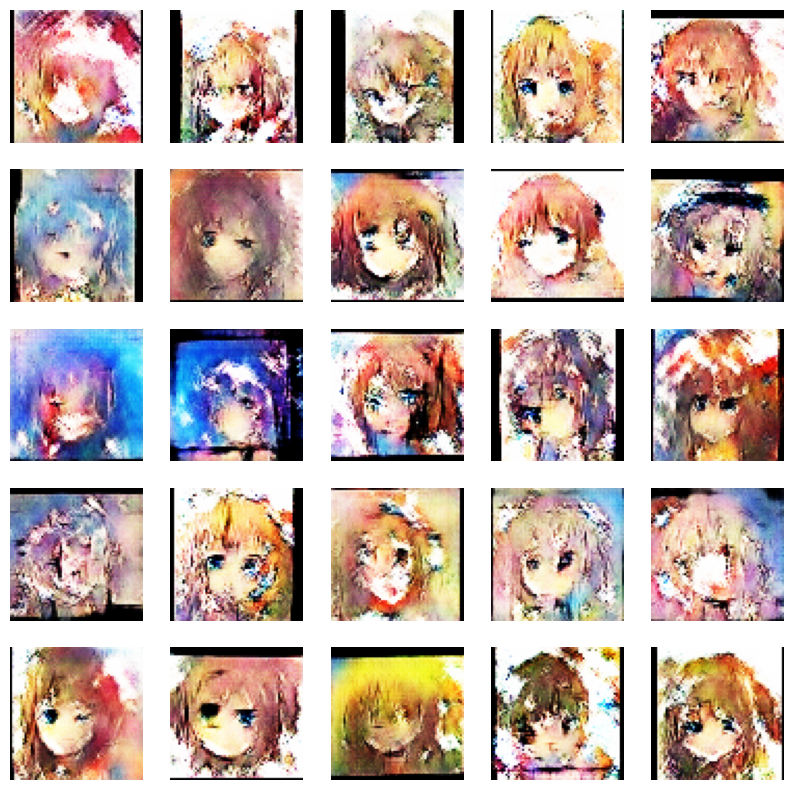

1183/1183 [==============================] - 690s 583ms/step - d_loss: -1.5121 - g_loss: 4.6107
Epoch 13/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.4899 - g_loss: 3.8026

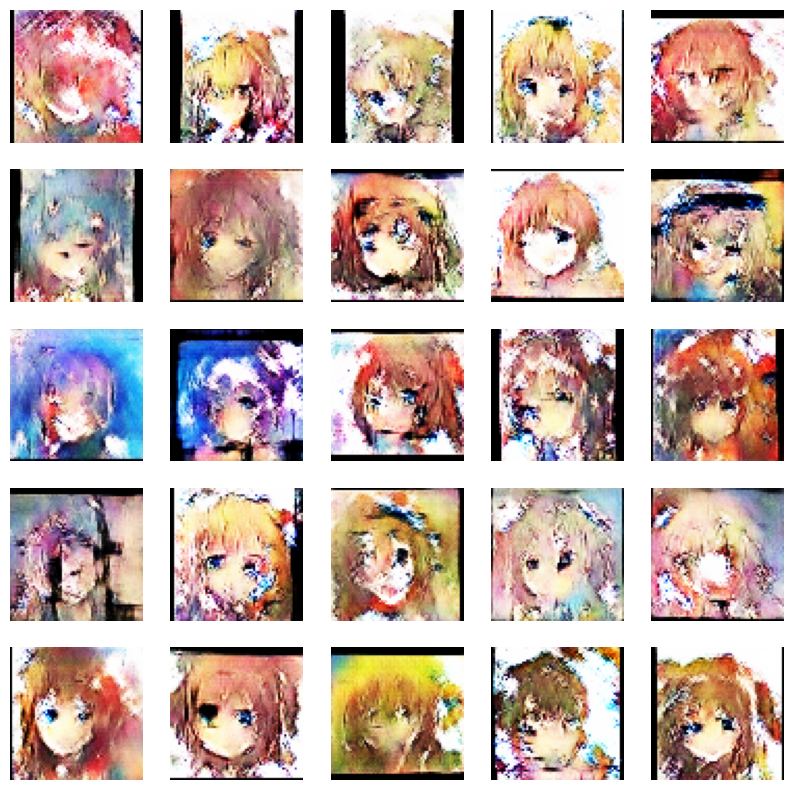

1183/1183 [==============================] - 687s 581ms/step - d_loss: -1.4894 - g_loss: 3.8101
Epoch 14/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.4285 - g_loss: 3.9691

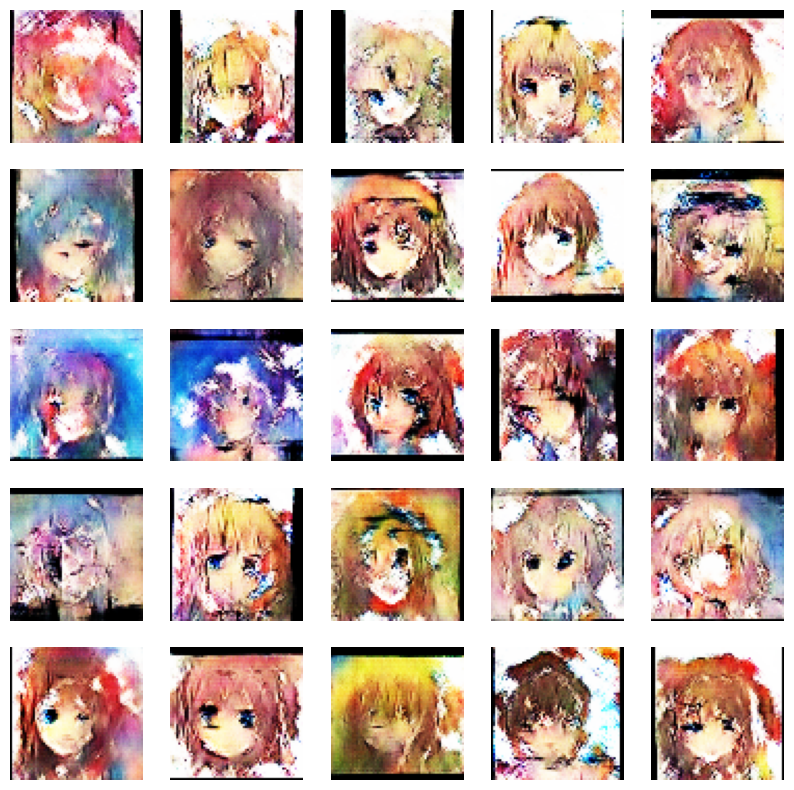

1183/1183 [==============================] - 682s 576ms/step - d_loss: -1.4264 - g_loss: 3.9724
Epoch 15/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.4035 - g_loss: 5.4618

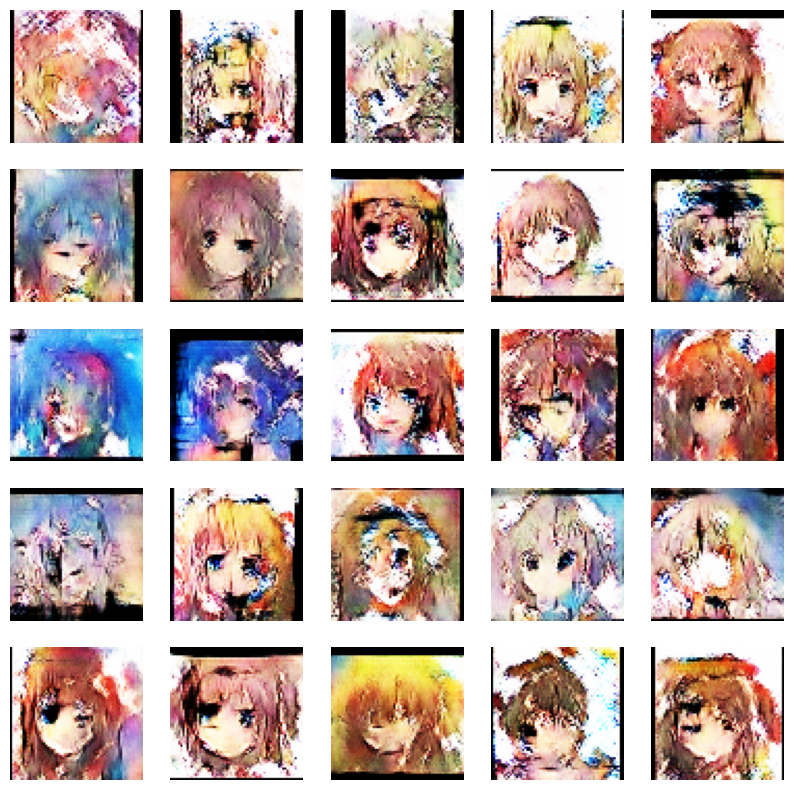

1183/1183 [==============================] - 682s 576ms/step - d_loss: -1.4048 - g_loss: 5.4721
Epoch 16/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.3537 - g_loss: 6.0531WARNING:tensorflow:Compiled the loaded model, but the compiled metrics have yet to be built. `model.compile_metrics` will be empty until you train or evaluate the model.


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_15/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_15/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_15/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_15/assets


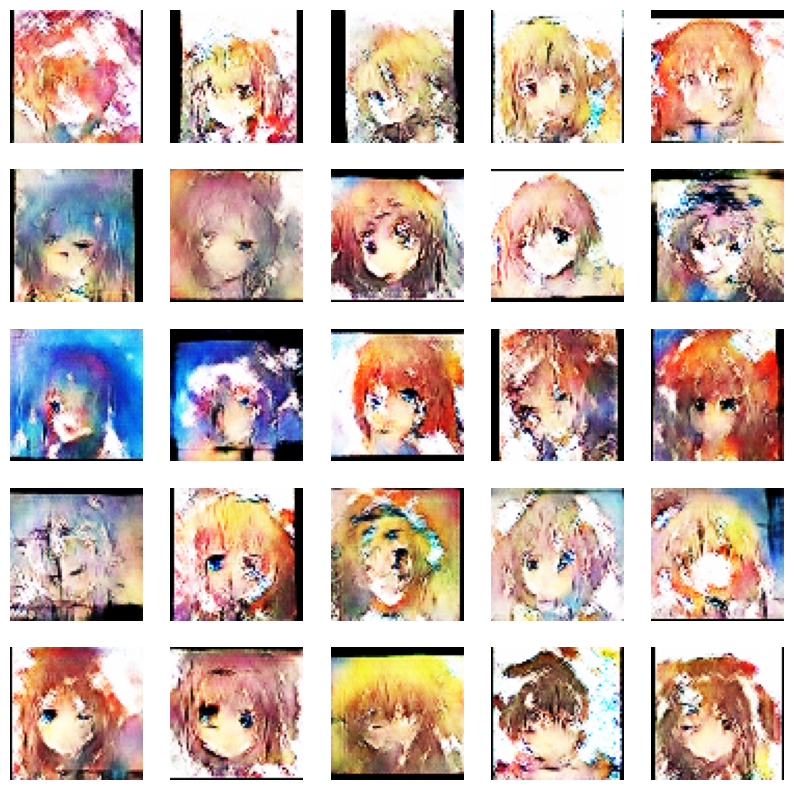

1183/1183 [==============================] - 684s 578ms/step - d_loss: -1.3551 - g_loss: 6.0490
Epoch 17/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.3477 - g_loss: 4.4018

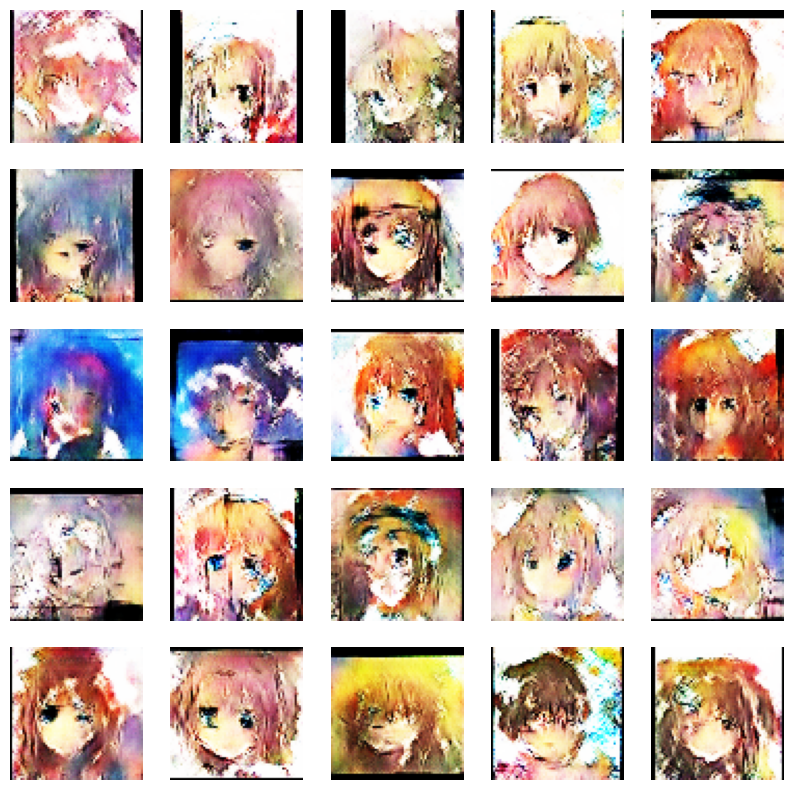

1183/1183 [==============================] - 682s 576ms/step - d_loss: -1.3469 - g_loss: 4.3948
Epoch 18/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.3163 - g_loss: 8.7753

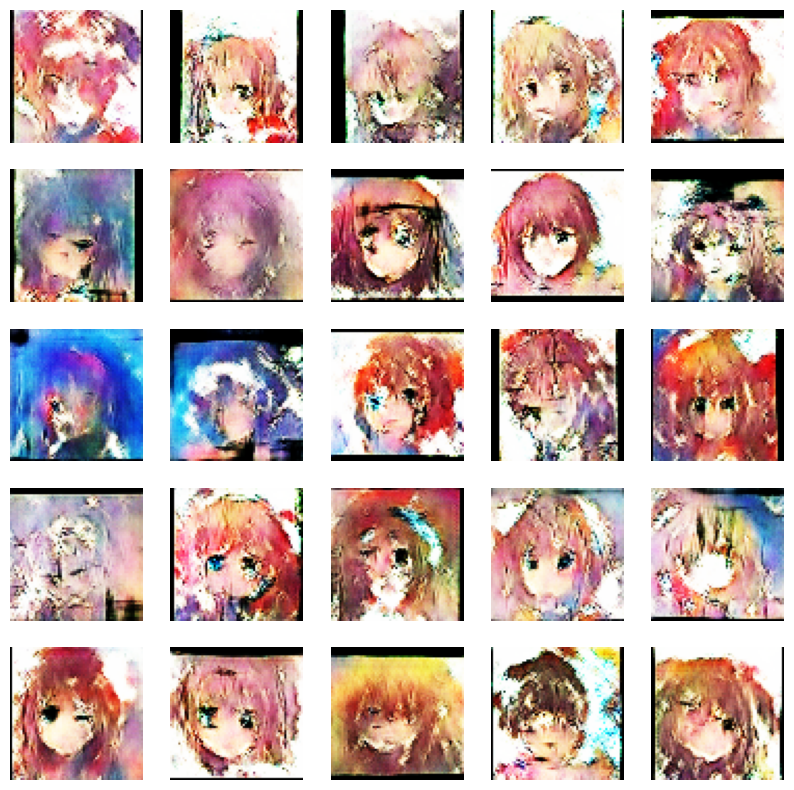

1183/1183 [==============================] - 683s 577ms/step - d_loss: -1.3154 - g_loss: 8.7697
Epoch 19/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.2326 - g_loss: 5.9551

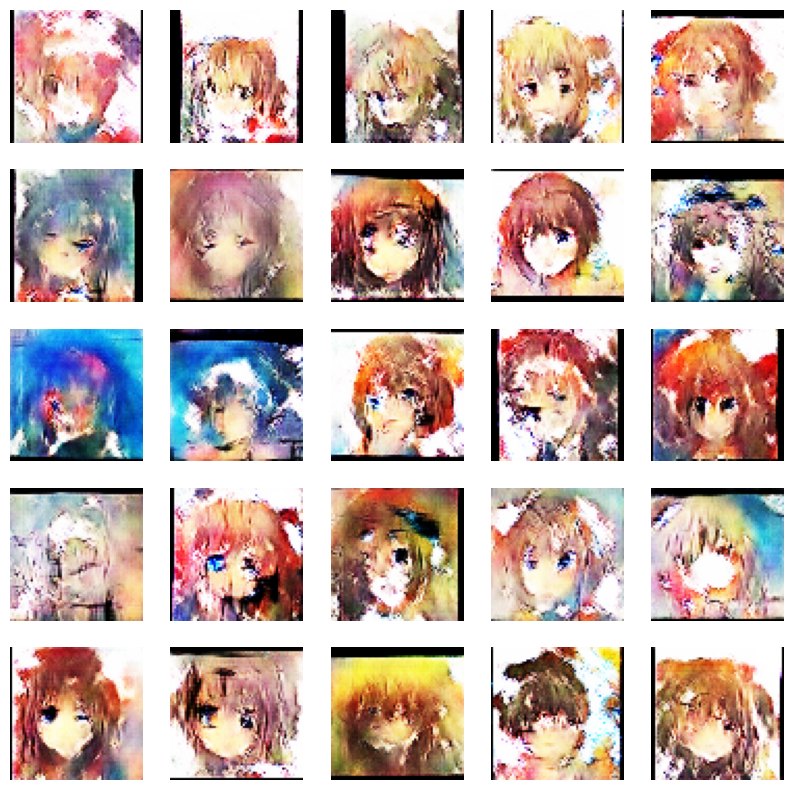

1183/1183 [==============================] - 688s 581ms/step - d_loss: -1.2334 - g_loss: 5.9588
Epoch 20/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.2421 - g_loss: 6.5713

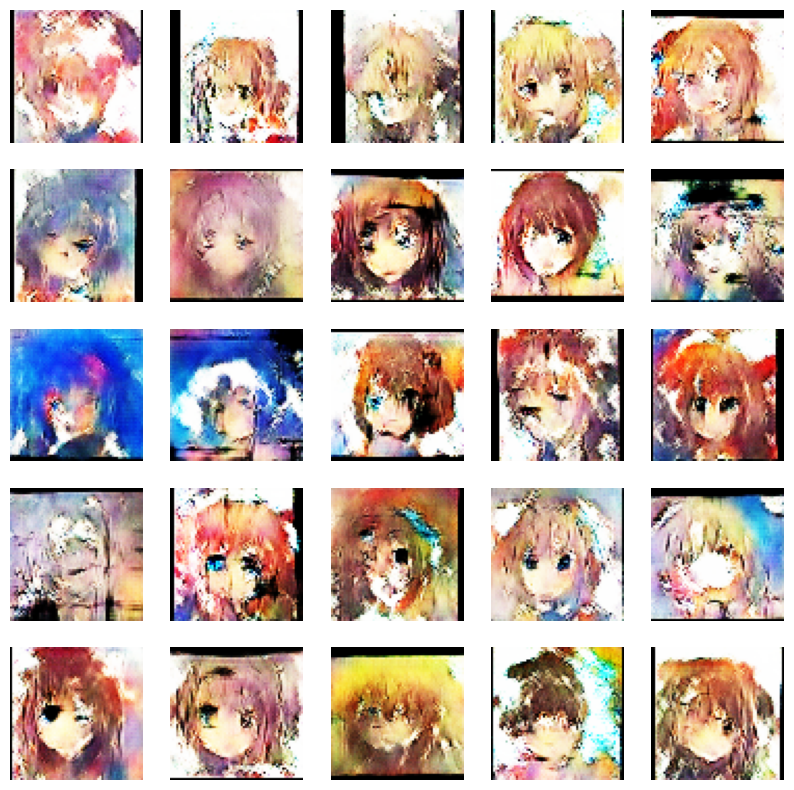

1183/1183 [==============================] - 685s 578ms/step - d_loss: -1.2442 - g_loss: 6.5683
Epoch 21/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.1754 - g_loss: 5.7754WARNING:tensorflow:Compiled the loaded model, but the compiled metrics have yet to be built. `model.compile_metrics` will be empty until you train or evaluate the model.


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_20/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_20/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_20/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_20/assets


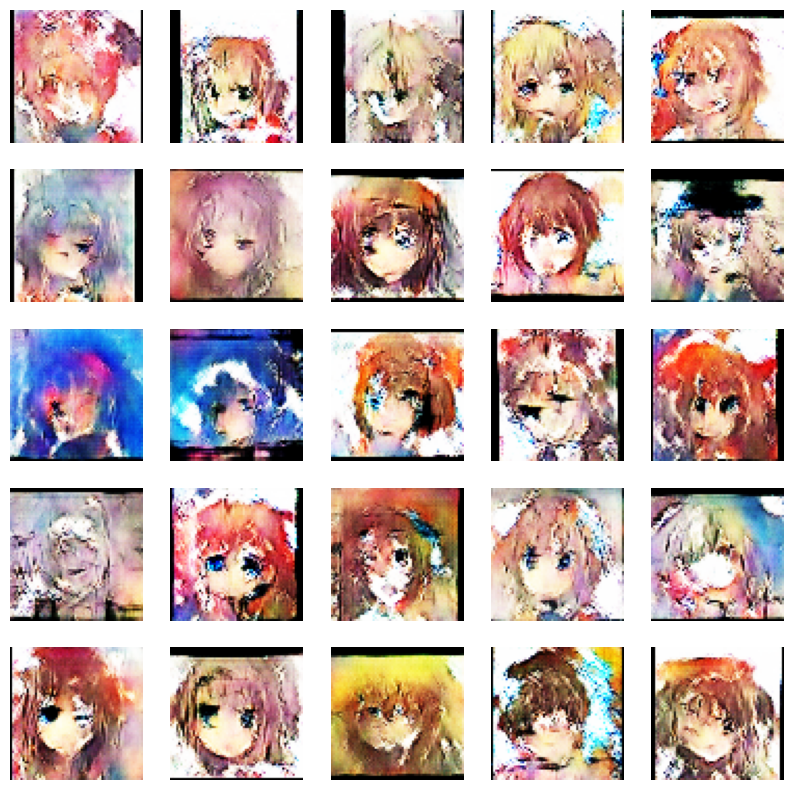

1183/1183 [==============================] - 702s 593ms/step - d_loss: -1.1747 - g_loss: 5.7727
Epoch 22/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.1182 - g_loss: 6.4247

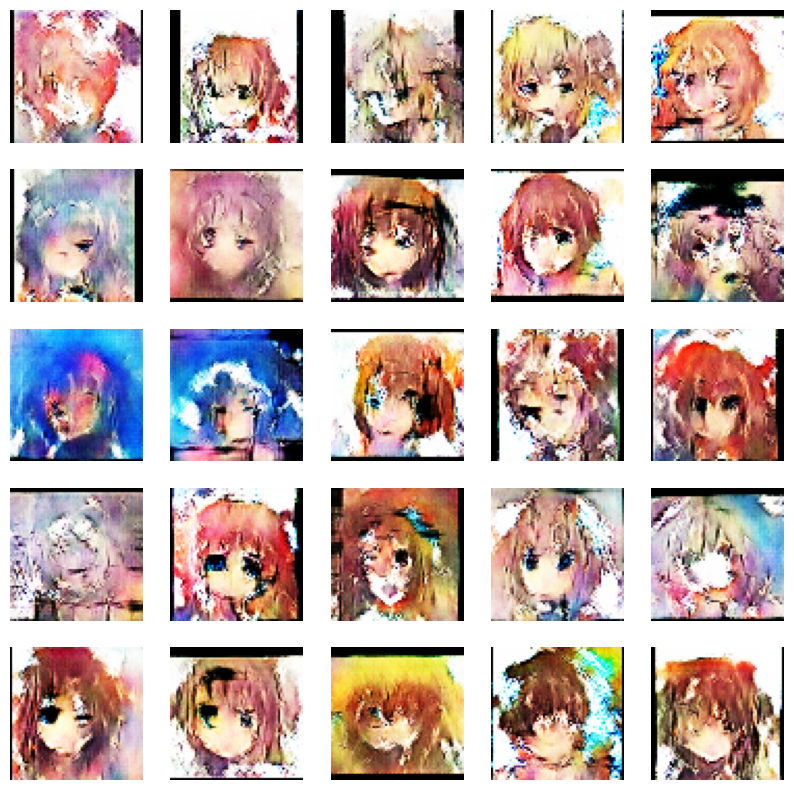

1183/1183 [==============================] - 706s 596ms/step - d_loss: -1.1178 - g_loss: 6.4171
Epoch 23/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.1128 - g_loss: 9.2427

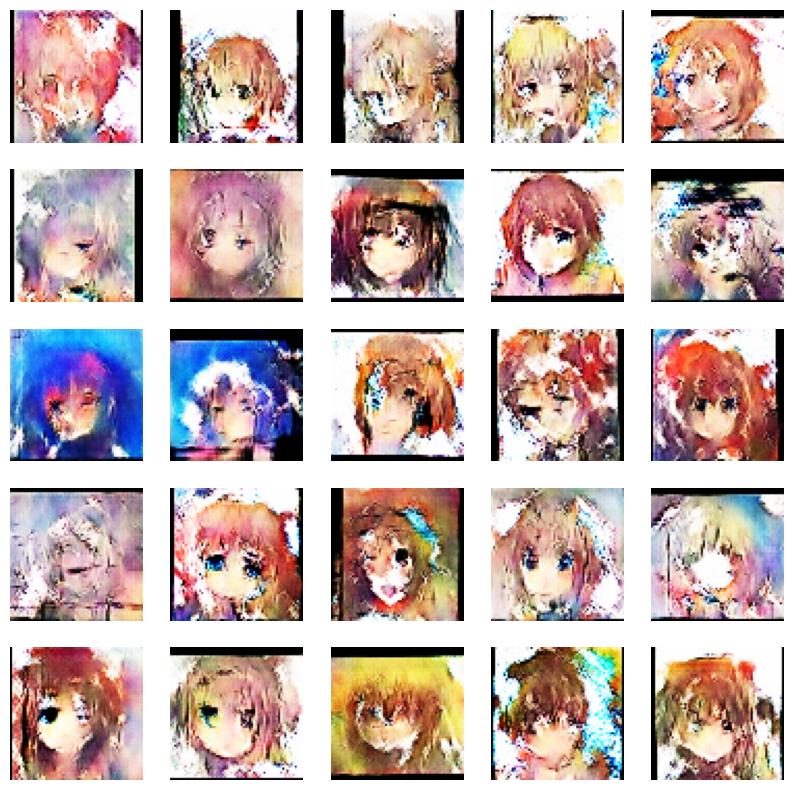

1183/1183 [==============================] - 711s 601ms/step - d_loss: -1.1142 - g_loss: 9.2369
Epoch 24/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.1012 - g_loss: 8.2858

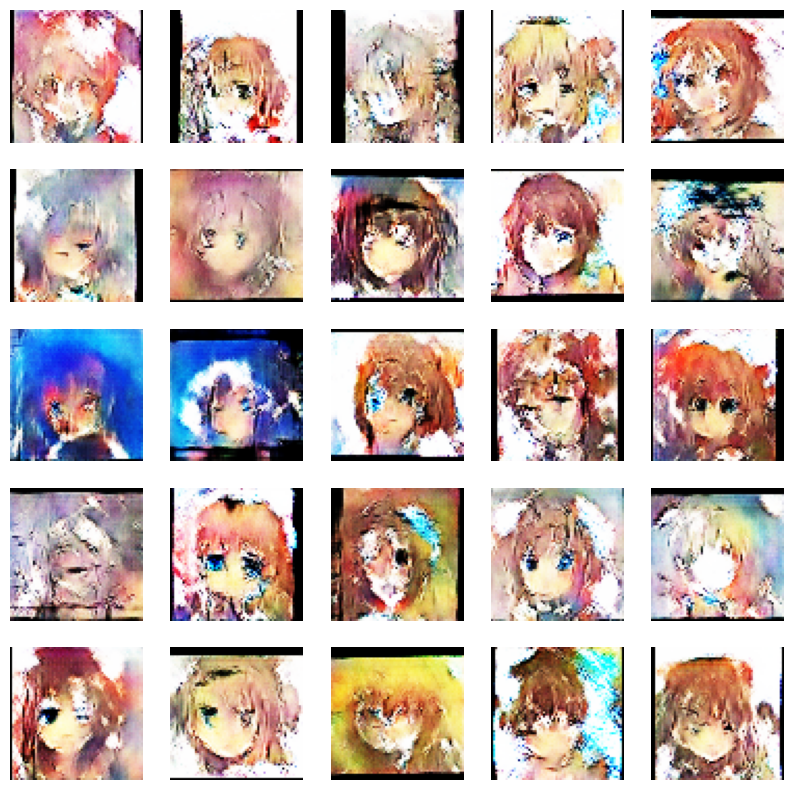

1183/1183 [==============================] - 707s 597ms/step - d_loss: -1.0987 - g_loss: 8.2978
Epoch 25/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.0953 - g_loss: 10.6473

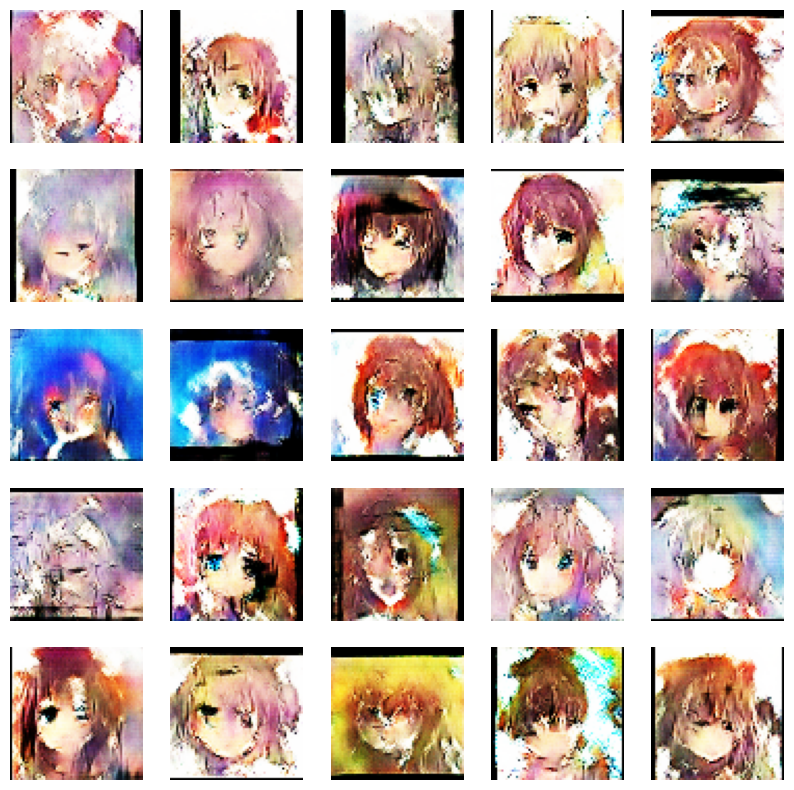

1183/1183 [==============================] - 711s 601ms/step - d_loss: -1.0957 - g_loss: 10.6529
Epoch 26/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.0638 - g_loss: 5.9052WARNING:tensorflow:Compiled the loaded model, but the compiled metrics have yet to be built. `model.compile_metrics` will be empty until you train or evaluate the model.


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_25/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_25/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_25/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_25/assets


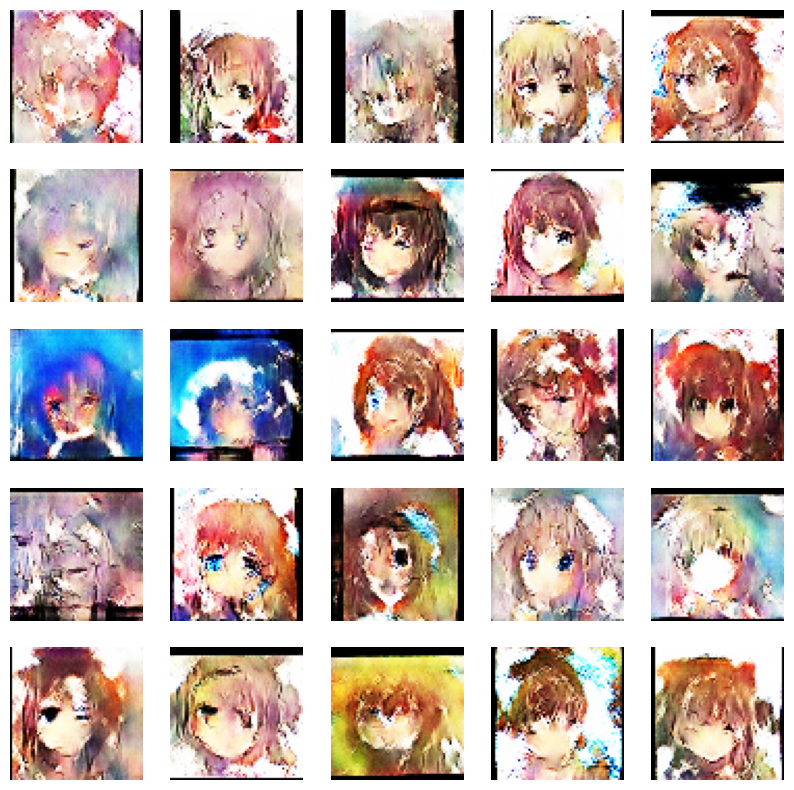

1183/1183 [==============================] - 704s 595ms/step - d_loss: -1.0631 - g_loss: 5.9058
Epoch 27/100
1183/1183 [==============================] - ETA: 0s - d_loss: -1.0193 - g_loss: 5.5045

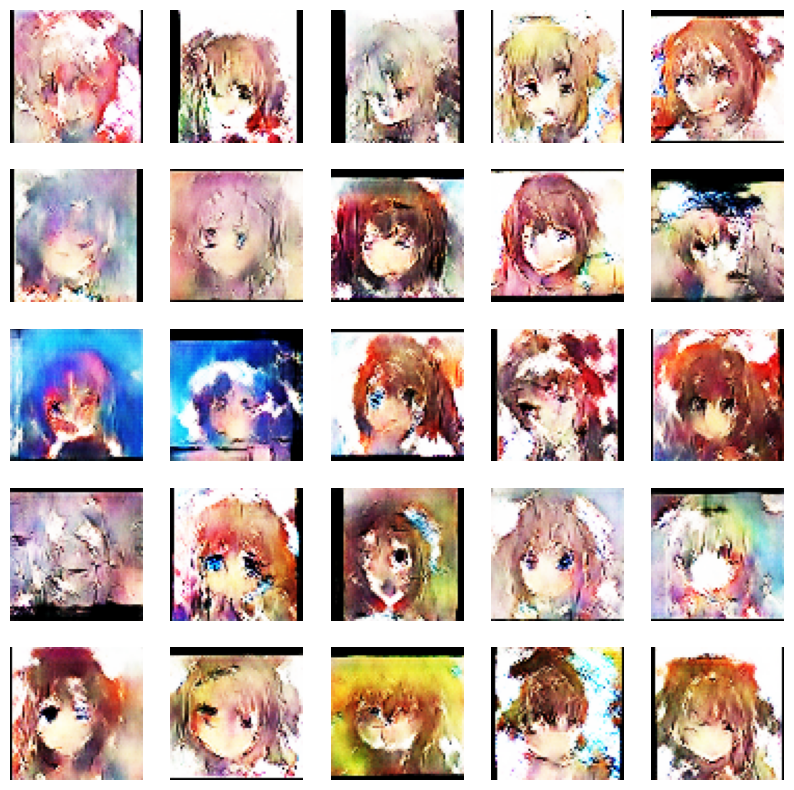

1183/1183 [==============================] - 697s 589ms/step - d_loss: -1.0179 - g_loss: 5.4984
Epoch 28/100
1183/1183 [==============================] - ETA: 0s - d_loss: -0.9475 - g_loss: 8.3342

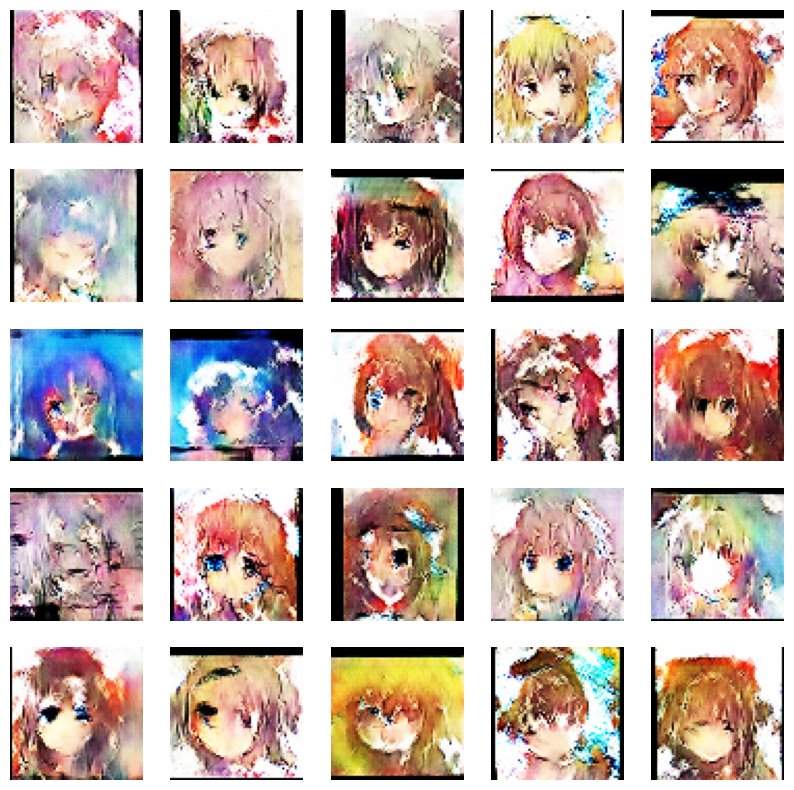

1183/1183 [==============================] - 691s 584ms/step - d_loss: -0.9470 - g_loss: 8.3459
Epoch 29/100
1183/1183 [==============================] - ETA: 0s - d_loss: -0.9977 - g_loss: 8.0778

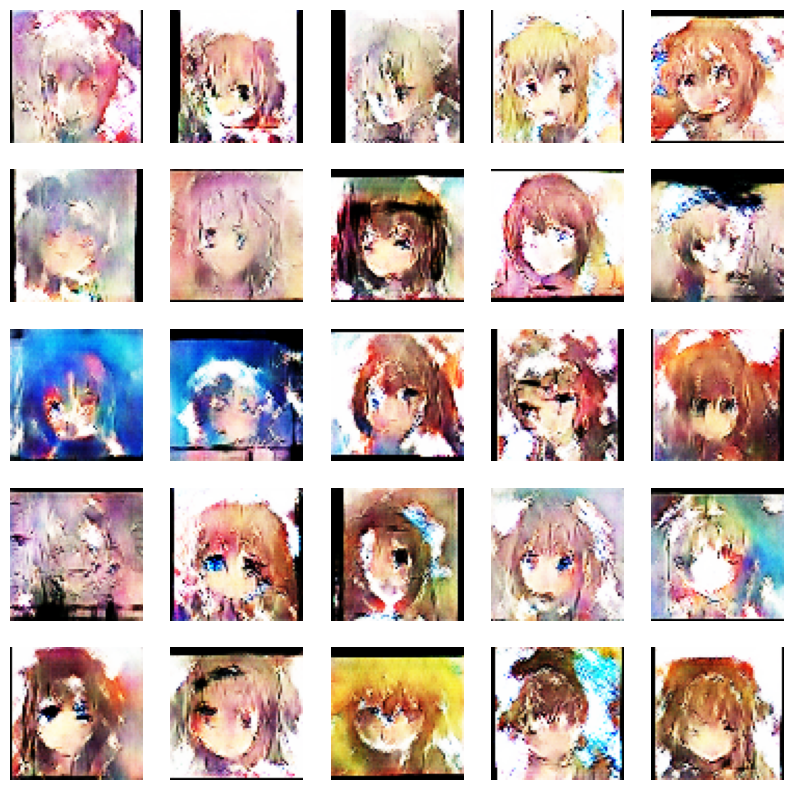

1183/1183 [==============================] - 682s 576ms/step - d_loss: -0.9993 - g_loss: 8.0358
Epoch 30/100
1183/1183 [==============================] - ETA: 0s - d_loss: -0.9297 - g_loss: 9.3910

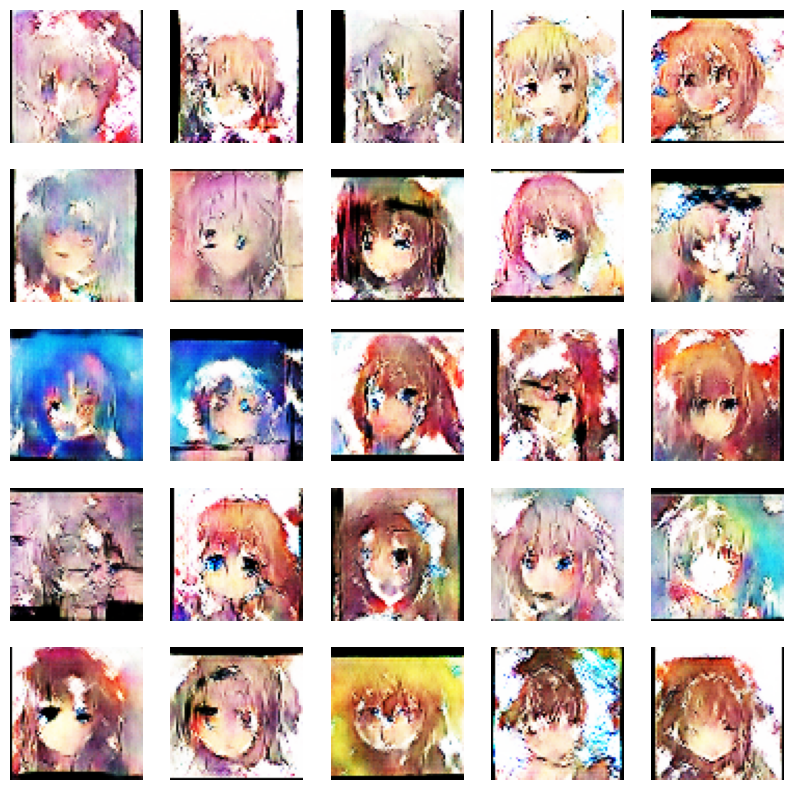

1183/1183 [==============================] - 682s 576ms/step - d_loss: -0.9289 - g_loss: 9.3854
Epoch 31/100
1183/1183 [==============================] - ETA: 0s - d_loss: -0.8714 - g_loss: 8.5003WARNING:tensorflow:Compiled the loaded model, but the compiled metrics have yet to be built. `model.compile_metrics` will be empty until you train or evaluate the model.


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_30/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/generator_after_epoch_30/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_30/assets


INFO:tensorflow:Assets written to: /home/guillaume/code/35m5loKiUe/WGAN_DATA/model_saves/discriminator_after_epoch_30/assets


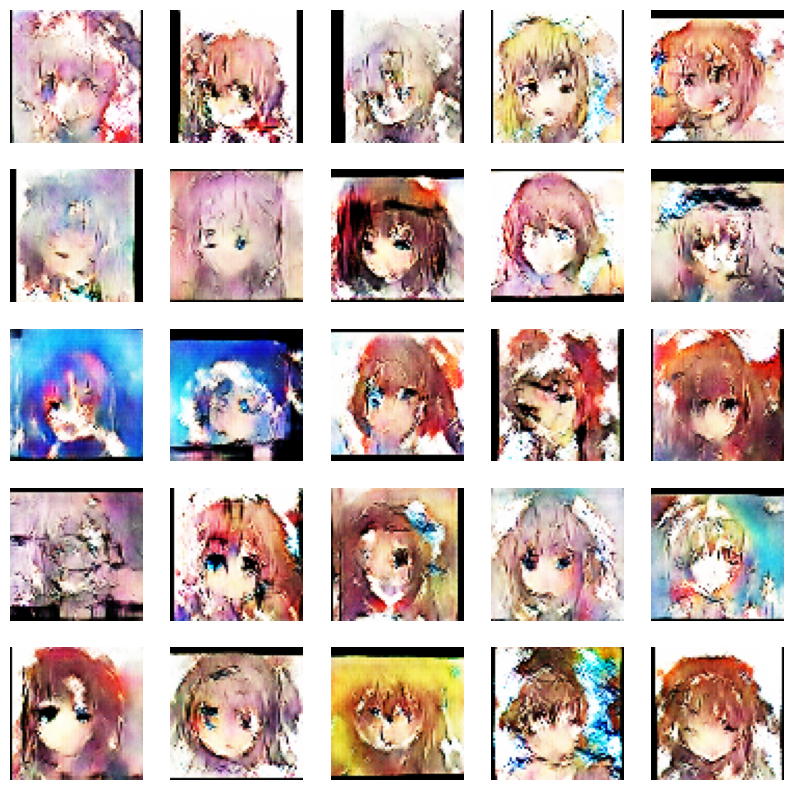

1183/1183 [==============================] - 684s 578ms/step - d_loss: -0.8724 - g_loss: 8.5017
Epoch 32/100
1118/1183 [===========================>..] - ETA: 37s - d_loss: -0.5651 - g_loss: 10.6841

In [ ]:
# Start training
wgan.fit(train_dataset, batch_size=BATCH_SIZE, epochs=EPOCHS, callbacks=[cbk])

In [ ]:
epoch = 60
generator = keras.models.load_model(os.path.join(ROOT_PATH, MODEL_PATH, 'generator_after_epoch_{epoch}').format(epoch=epoch))
generator = keras.models.load_model(os.path.join(ROOT_PATH, MODEL_PATH, 'discriminator_after_epoch_{epoch}').format(epoch=epoch))

In [ ]:
plt.imshow(np.squeeze(generator.predict(tf.random.normal(shape=(1, 100))), axis=0))